In [1]:
!pip install mtcnn
import numpy as np
%pylab inline
import matplotlib.pyplot as plt
from scipy import signal
import os
import io
from keras.models import Sequential
from keras.layers import Dense, Conv2D, MaxPooling2D, Dropout, Flatten
from keras import models
from keras.utils.np_utils import to_categorical
import skimage.draw
from sklearn.model_selection import train_test_split
from sklearn.metrics import confusion_matrix
from keras.applications import vgg16
from keras.applications.vgg16 import preprocess_input
from os import listdir
from PIL import Image
from numpy import asarray
from matplotlib import pyplot
from mtcnn.mtcnn import MTCNN
from os.path import isdir
from numpy import savez_compressed
from numpy import asarray

from numpy.random import seed 
seed(42)# keras seed fixing 
import tensorflow as tf 
tf.random.set_seed(42)# tensorflow seed fixing

You should consider upgrading via the 'c:\users\kavya\appdata\local\programs\python\python36\python.exe -m pip install --upgrade pip' command.


Populating the interactive namespace from numpy and matplotlib


In [2]:
import keras
keras.__version__

'2.4.3'

In [3]:
print(tf.__version__)

2.4.1


In [4]:
import matplotlib.pyplot as plt
from matplotlib import patches

def show_detected_face(result, detected, title="Face image"):
    plt.figure(figsize=(12, 10))
    plt.imshow(result)
    img_desc = plt.gca()
    plt.set_cmap('gray')
    plt.title(title)
    plt.axis('off')
    if len(detected) > 0:
      for patch in detected:
          
          img_desc.add_patch(
              patches.Rectangle(
                  (patch['c'], patch['r']),
                  patch['width'],
                  patch['height'],
                  fill=False,
                  color='r',
                  linewidth=2)
          )
    plt.show()

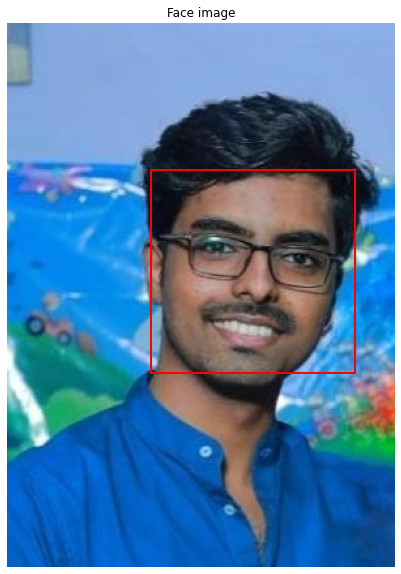

In [5]:
from skimage import data, io
from skimage.feature import Cascade


# Load the trained file from the module root.
trained_file = data.lbp_frontal_face_cascade_filename()

# Initialize the detector cascade.
detector = Cascade(trained_file)

face_image = io.imread('Nikhil.jpg')

detected = detector.detect_multi_scale(img=face_image,
                                       scale_factor=1.2,
                                       step_ratio=1,
                                       min_size=(80, 80),
                                       max_size=(1000, 1000))

show_detected_face(face_image, detected)

[{'r': 112, 'c': 110, 'width': 156, 'height': 156}]


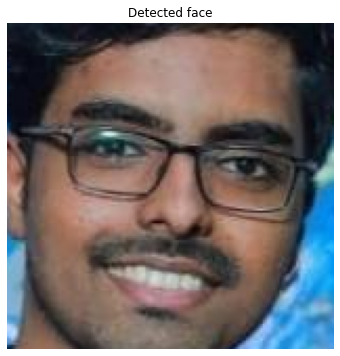

In [6]:
def crop_face(result, detected, title="Detected face"):
  if len(detected) >0:
      rostro= result[detected[0]['r']:detected[0]['r']+detected[0]['width'], detected[0]['c']:detected[0]['c']+detected[0]['height']]
      plt.figure(figsize=(8, 6))
      plt.imshow(rostro)    
      plt.title(title)
      plt.axis('off')
      plt.show()

print(detected)
crop_face(face_image, detected)

1 (160, 160, 3)
2 (160, 160, 3)
3 (160, 160, 3)


4 (160, 160, 3)
5 (160, 160, 3)


6 (160, 160, 3)
7 (160, 160, 3)


8 (160, 160, 3)
9 (160, 160, 3)


ValueError: num must be 1 <= num <= 8, not 9

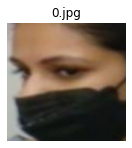

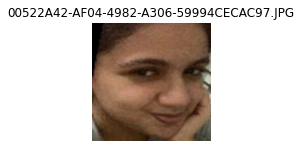

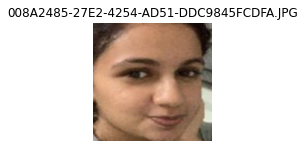

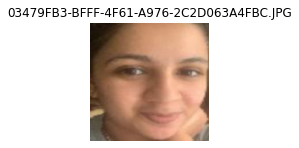

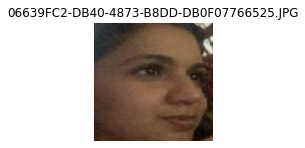

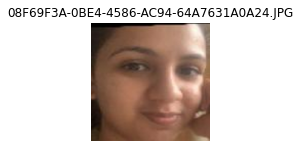

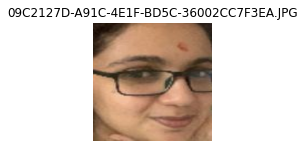

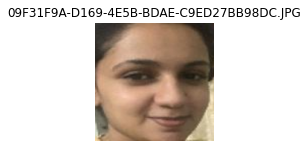

<Figure size 864x720 with 0 Axes>

In [7]:
# extract a single face from a given photograph
def extract_face(filename, required_size=(160, 160)):
  # load image from file
  image = Image.open(filename)
  # convert to RGB, if needed
  image = image.convert('RGB')
  # convert to array
  pixels = asarray(image)
  # create the detector, using default weights
  detector = MTCNN()
  # detect faces in the image
  results = detector.detect_faces(pixels)
  # extract the bounding box from the first face
  try:
    x1, y1, width, height = results[0]['box']
    # bug fix
    x1, y1 = abs(x1), abs(y1)
    x2, y2 = x1 + width, y1 + height
    # extract the face
    face = pixels[y1:y2, x1:x2]
    # resize pixels to the model size
    image = Image.fromarray(face)
    image = image.resize(required_size)
    face_array = asarray(image)
    return face_array
  except IndexError:
    face_array=[]
    print("Out of index")

# specify folder to plot
i = 1
folder = 'C:/Users/Kavya/Downloads/Dataset Prefinal/Dataset Prefinal/Training/Kavya/'
# enumerate files
for filename in listdir(folder):
  # path
  path = folder + filename
  # get face
  face = extract_face(path)
  from matplotlib.pyplot import figure
  figure(num=None, figsize=(12, 10))
  if face is not None:
    print(i, face.shape)
    # plot
    pyplot.subplot(4, 2, i)
    pyplot.title(filename)
    pyplot.axis('off')
    pyplot.imshow(face)
    i += 1
pyplot.show()

In [8]:
from os import listdir
from os.path import isdir
from PIL import Image
from matplotlib import pyplot
from numpy import savez_compressed
from numpy import asarray
from mtcnn.mtcnn import MTCNN


# extract a single face from a given photograph
def extract_face(filename, required_size=(224, 224)):
  # load image from file
  image = Image.open(filename)
  # convert to RGB, if needed
  image = image.convert('RGB')
  # convert to array
  pixels = asarray(image)
  # create the detector, using default weights
  detector = MTCNN()
  # detect faces in the image
  results = detector.detect_faces(pixels)
  # extract the bounding box from the first face
  try:
    x1, y1, width, height = results[0]['box']
    # bug fix
    x1, y1 = abs(x1), abs(y1)
    x2, y2 = x1 + width, y1 + height
    # extract the face
    face = pixels[y1:y2, x1:x2]
    # resize pixels to the model size
    image = Image.fromarray(face)
    image = image.resize(required_size)
    face_array = asarray(image)
    return face_array
  except IndexError:
    face_array=[]
    print("Out of index")
  
 
# load images and extract faces for all images in a directory
def load_faces(directory):
  faces = list()
  # enumerate files
  for filename in listdir(directory):
    # path
    path = directory + filename
    # get face
    face = extract_face(path)
    if face is not None:
      # store
      faces.append(face)
  return faces
 
# load a dataset that contains one subdir for each class that in turn contains images
def load_dataset(directory):
	X, y = list(), list()
	# enumerate folders, on per class
	for subdir in listdir(directory):
		# path
		path = directory + subdir + '/'
		# skip any files that might be in the dir
		if not isdir(path):
			continue
		# load all faces in the subdirectory
		faces = load_faces(path)
		# create labels
		labels = [subdir for _ in range(len(faces))]
		# summarize progress
		print('>loaded %d examples for class: %s' % (len(faces), subdir))
		# store
		X.extend(faces)
		y.extend(labels)
	return asarray(X), asarray(y)

In [9]:
# extract all faces from a given photograph
def extract_all_faces(filename, required_size=(224, 224)):
  # load image from file
  original_image = Image.open(filename)
  # convert to RGB, if needed
  image = original_image.convert('RGB')
  # convert to array
  pixels = asarray(image)
  # create the detector, using default weights
  detector = MTCNN()
  # detect faces in the image
  results = detector.detect_faces(pixels)
  # extract the bounding box from the faces
  face_array=[]
  try:
    for result in results:
      x1, y1, width, height = result['box']
      x1, y1 = abs(x1), abs(y1)
      x2, y2 = x1 + width, y1 + height
      # extract the face
      face = pixels[y1:y2, x1:x2]
      #print()
      #print(original_image)
      #print(face.shape[0])
      #print("original_image.size[0]/20")
      #print(original_image.size[0]/20)
      if face.shape[0] >= original_image.size[0]/20:
        print(face.shape)
        # resize pixels to the model size
        image = Image.fromarray(face)
        image = image.resize(required_size)
        face_array.append(asarray(image))

    return face_array
  except IndexError:
    print("Out of index")

In [90]:
# Generate face training dataset from file folders

trainX, trainy = load_dataset('C:/Users/Kavya/Downloads/Dataset Prefinal/Dataset Prefinal/Training/')
print(trainX.shape, trainy.shape)
# load test dataset
# save arrays to one file in compressed format
savez_compressed('photos1.npz', trainX, trainy)
x_train_cam, y_train_cam = data['arr_0'], data['arr_1']    #m
print('Loaded: ', x_train_cam.shape, y_train_cam.shape)    #m

Out of index


Out of index


Out of index


Out of index


Out of index


>loaded 897 examples for class: Kavya


Out of index


Out of index


Out of index


Out of index


Out of index


Out of index


Out of index


Out of index


Out of index


Exception ignored in: <function WeakKeyDictionary.__init__.<locals>.remove at 0x0000020FF75C4488>
Traceback (most recent call last):
  File "c:\users\kavya\appdata\local\programs\python\python36\lib\weakref.py", line 357, in remove
    self = selfref()
KeyboardInterrupt


Out of index
Out of index
Out of index


Out of index


Out of index
Out of index


Out of index
Out of index


Out of index
Out of index


Out of index


Out of index


Out of index
Out of index


Out of index


Out of index


Out of index


Out of index


Out of index


Out of index


Out of index


>loaded 894 examples for class: Nikhil M Nair


KeyboardInterrupt: 

In [71]:
# Generate face training dataset from file folders

trainX, trainy = load_dataset('C:/Users/Kavya/Downloads/Kavu/Kavu/')
print(trainX.shape, trainy.shape)
# load test dataset
# save arrays to one file in compressed format
np.savez_compressed('Kavya.npz', trainX, trainy)
x_train_kavu, y_train_kavu = data['arr_0'], data['arr_1']
print('Loaded: ', x_train_kavu.shape, y_train_kavu.shape)

Out of index


Out of index


Out of index


Out of index


Out of index


>loaded 897 examples for class: Kavya
(897, 224, 224, 3) (897,)


TypeError: 'module' object is not subscriptable

In [72]:
trainX.shape

(897, 224, 224, 3)

In [73]:
trainy[1]

'Kavya'

In [74]:
# Generate face training dataset from file folders

trainX, trainy = load_dataset('C:/Users/Kavya/Downloads/Nair/Nair/')
print(trainX.shape, trainy.shape)
# load test dataset
# save arrays to one file in compressed format
np.savez_compressed('NikNair.npz', trainX, trainy)
x_train_nair, y_train_nair = data['arr_0'], data['arr_1']
print('Loaded: ', x_train_nair.shape, y_train_nair.shape)

Out of index


Out of index


Out of index


Out of index


Out of index


Out of index


Out of index


Out of index


Out of index


Out of index
Out of index


Out of index


Out of index


Out of index
Out of index


Out of index
Out of index


Out of index
Out of index


Out of index
Out of index


Out of index
Out of index


Out of index


Out of index


Out of index


Out of index


Out of index


Out of index


Out of index


>loaded 894 examples for class: Nikhil M Nair
(894, 224, 224, 3) (894,)


TypeError: 'module' object is not subscriptable

In [75]:
trainX.shape

(894, 224, 224, 3)

In [76]:
trainy[1]

'Nikhil M Nair'

In [77]:
# Generate face training dataset from file folders

trainX, trainy = load_dataset('C:/Users/Kavya/Downloads/Nik/Nik/')
print(trainX.shape, trainy.shape)
# load test dataset
# save arrays to one file in compressed format
np.savez_compressed('Nik.npz', trainX, trainy)
x_train_nik, y_train_nik = data['arr_0'], data['arr_1']
print('Loaded: ', x_train_nik.shape, y_train_nik.shape)

Out of index


Out of index


Out of index
Out of index
Out of index


Out of index
Out of index
Out of index


Out of index
Out of index


Out of index
Out of index


Out of index
Out of index


Out of index
Out of index
Out of index


Out of index
Out of index


Out of index
Out of index


Out of index


Out of index


>loaded 743 examples for class: Nikhil V Gopal
(743, 224, 224, 3) (743,)


TypeError: 'module' object is not subscriptable

In [78]:
trainX.shape

(743, 224, 224, 3)

In [79]:
trainy[1]

'Nikhil V Gopal'

In [80]:
# Generate face training dataset from file folders

trainX, trainy = load_dataset('C:/Users/Kavya/Downloads/Nit/Nit/')
print(trainX.shape, trainy.shape)
# load test dataset
# save arrays to one file in compressed format
np.savez_compressed('Nithya.npz', trainX, trainy)
x_train_nithya, y_train_nithya = data['arr_0'], data['arr_1']
print('Loaded: ', x_train_nithya.shape, y_train_nithya.shape)

Out of index
Out of index


Out of index


Out of index
Out of index


Out of index
Out of index


Out of index


>loaded 788 examples for class: Nithya
(788, 224, 224, 3) (788,)


TypeError: 'module' object is not subscriptable

In [81]:
trainX.shape

(788, 224, 224, 3)

In [82]:
trainy[1]

'Nithya'

In [83]:
# load the faces dataset from npz files

In [10]:
# load the faces dataset from npz files# load the faces dataset
data = load('Kavya.npz')     
x_train_kavu, y_train_kavu = data['arr_0'], data['arr_1']
print('Loaded: ', x_train_kavu.shape, y_train_kavu.shape)

Loaded:  (897, 224, 224, 3) (897,)


In [11]:
# load the faces dataset from npz files
data = load('NikNair.npz')     
x_train_nair, y_train_nair = data['arr_0'], data['arr_1']
print('Loaded: ', x_train_nair.shape, y_train_nair.shape)

Loaded:  (894, 224, 224, 3) (894,)


In [12]:
# load the faces dataset from npz files
data = load('Nik.npz')     
x_train_nik, y_train_nik = data['arr_0'], data['arr_1']
print('Loaded: ', x_train_nik.shape, y_train_nik.shape)

Loaded:  (743, 224, 224, 3) (743,)


In [13]:
# load the faces dataset from npz files
data = load('Nithya.npz')     
x_train_nithya, y_train_nithya = data['arr_0'], data['arr_1']
print('Loaded: ', x_train_nithya.shape, y_train_nithya.shape)

Loaded:  (788, 224, 224, 3) (788,)


In [14]:
# load the faces dataset from npz files
data = load('photos_1.npz')     
x_train_cam, y_train_cam = data['arr_0'], data['arr_1']
print('Loaded: ', x_train_cam.shape, y_train_cam.shape)

Loaded:  (3319, 224, 224, 3) (3319,)


In [15]:
np.unique(y_train_cam, return_counts=True)

(array(['Kavya', 'Nikhil M Nair', 'Nikhil V Gopal', 'Nithya'], dtype='<U14'),
 array([898, 891, 743, 787], dtype=int64))

In [16]:
x_train = np.concatenate((x_train_cam, x_train_kavu), axis=0)
x_train.shape

(4216, 224, 224, 3)

In [17]:
x_train = np.concatenate((x_train_cam, x_train_nair), axis=0)
x_train.shape

(4213, 224, 224, 3)

In [18]:
x_train = np.concatenate((x_train_cam, x_train_nik), axis=0)
x_train.shape

(4062, 224, 224, 3)

In [19]:
x_train = np.concatenate((x_train_cam, x_train_nithya), axis=0)
x_train.shape

(4107, 224, 224, 3)

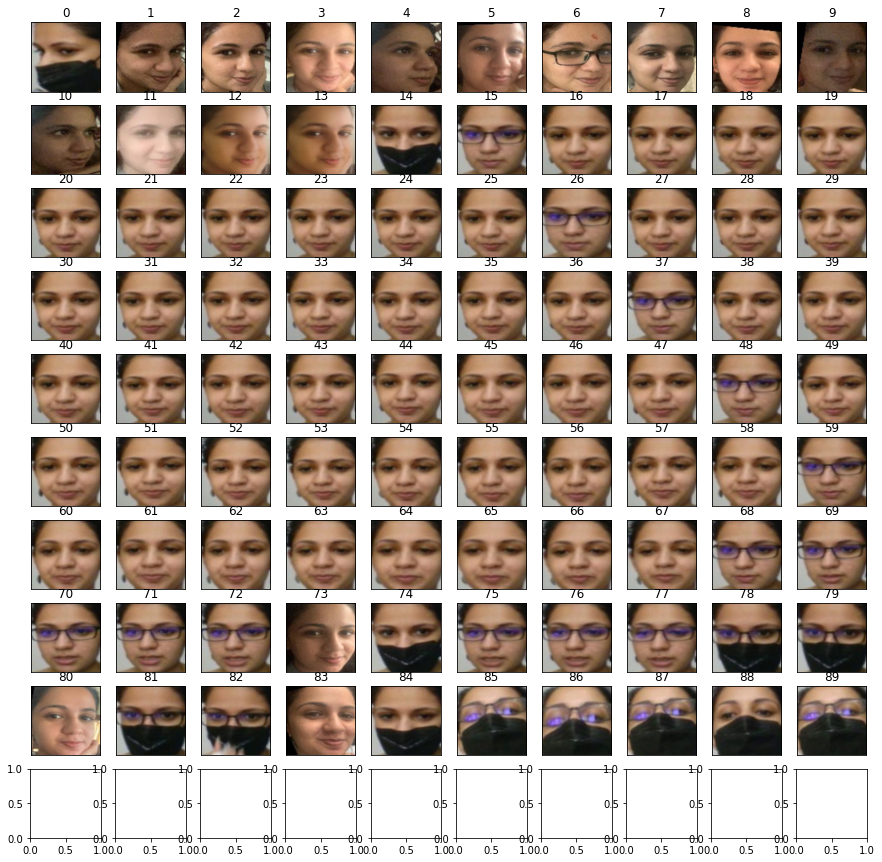

In [20]:
plt.subplots(10,10,figsize=(15,15))
for i in range(90):
    plt.subplot(10,10,i+1)
    plt.title(i*1)
    plt.imshow(x_train_kavu[i*1])
    plt.xticks([])
    plt.yticks([])

In [21]:
# load the faces dataset
data = load('photos_1.npz')     
X, Y = data['arr_0'], data['arr_1']
print('Loaded: ', X.shape, Y.shape)

Loaded:  (3319, 224, 224, 3) (3319,)


In [22]:
img = X[100]

In [23]:
import cv2
import random
import numpy as np

def brightness(img, low, high):
    value = random.uniform(low, high)
    hsv = cv2.cvtColor(img, cv2.COLOR_BGR2HSV)
    hsv = np.array(hsv, dtype = np.float64)
    hsv[:,:,1] = hsv[:,:,1]*value
    hsv[:,:,1][hsv[:,:,1]>255]  = 255
    hsv[:,:,2] = hsv[:,:,2]*value 
    hsv[:,:,2][hsv[:,:,2]>255]  = 255
    hsv = np.array(hsv, dtype = np.uint8)
    img = cv2.cvtColor(hsv, cv2.COLOR_HSV2BGR)
    return img

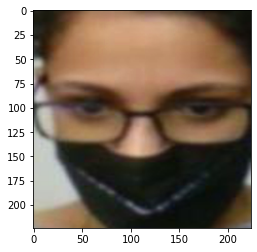

In [24]:
img_result = brightness(img, 0.1, 2)
plt.imshow(img_result)


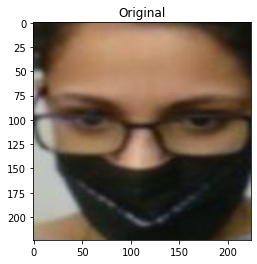

In [25]:
plt.title("Original")
plt.imshow(img)

In [26]:
import cv2
import random

def augment_data(imgs, scales, rotations, brightness_values, shifts, labels):
  timg=[]
  y_hat=[]
  for (img,label) in zip(imgs,labels):
    rows, cols, ch = img.shape 
    for j in rotations:
      f = random.uniform(0, 1)
      #f = random.choice([0,1])
      rot_mat = cv2.getRotationMatrix2D( (14,14), j, 1);
      affined_img = cv2.warpAffine( img, rot_mat, (cols, rows), borderValue=(1,1,1))
      resulting_img = affined_img
      if f == 1:
        resulting_img = cv2.flip(resulting_img, f)
      resulting_img = brightness(resulting_img, brightness_values[0], brightness_values[1])
      timg.append(resulting_img)
      y_hat.append(label)
  return np.array(timg), np.array(y_hat)

In [27]:
scales = np.arange(0.9, 1, 0.1)
rotations = np.arange(0, 2)
brightness_values = [ 0.4, 2]
shifts = [ 0.2]
au_x, au_y = augment_data(X, scales, rotations, brightness_values, shifts, Y)

In [28]:
au_x.shape

(6638, 224, 224, 3)

In [29]:
np.unique(au_y, return_counts=True)

(array(['Kavya', 'Nikhil M Nair', 'Nikhil V Gopal', 'Nithya'], dtype='<U14'),
 array([1796, 1782, 1486, 1574], dtype=int64))

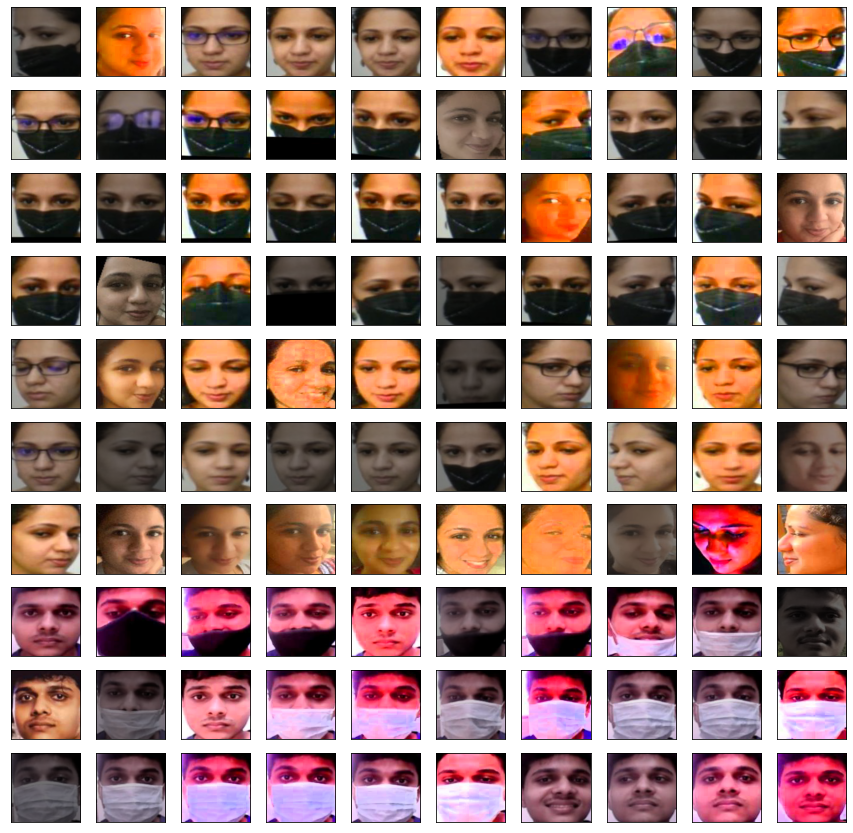

In [30]:
plt.subplots(10,10,figsize=(15,15))
for i in range(100):
    plt.subplot(10,10,i+1)
    plt.imshow(au_x[i*26])
    plt.xticks([])
    plt.yticks([])

In [31]:
from sklearn.model_selection import train_test_split
# split into train test sets
au_x_train, au_x_test, au_y_train, au_y_test = train_test_split(au_x, au_y, test_size=0.33)
print(au_x_train.shape, au_x_test.shape, au_y_train.shape, au_y_test.shape)

(4447, 224, 224, 3) (2191, 224, 224, 3) (4447,) (2191,)


In [32]:
from sklearn.preprocessing import LabelEncoder
# label encode targets
out_encoder = LabelEncoder()
out_encoder.fit(au_y_train)
au_y_train = out_encoder.transform(au_y_train)
au_y_test = out_encoder.transform(au_y_test)

In [33]:
au_y_train.shape

(4447,)

In [34]:
au_y_test.shape

(2191,)

In [35]:
from keras.utils import to_categorical
au_train_labels = to_categorical(au_y_train)
au_test_labels = to_categorical(au_y_test)

print(au_train_labels.shape)
print(au_test_labels.shape)

(4447, 4)
(2191, 4)


In [114]:
# The data one-hot encoded 
savez_compressed('encoded.npz', au_x_train, au_train_labels, au_x_test, au_test_labels)

In [48]:
# load the faces dataset
data = load('encoded.npz')     
au_x_train, au_train_labels, au_x_test, au_test_labels= data['arr_0'], data['arr_1'],data['arr_2'], data['arr_3']
print('Loaded: ', au_x_train.shape, au_train_labels.shape,  au_x_test.shape, au_test_labels.shape)

Loaded:  (4447, 224, 224, 3) (4447, 4) (2191, 224, 224, 3) (2191, 4)


In [37]:
tf.global_variables_initializer()

AttributeError: module 'tensorflow' has no attribute 'global_variables_initializer'

In [49]:
from keras.layers import BatchNormalization, GlobalMaxPooling2D

model1 = Sequential()

# Convolution layers
model1.add(Conv2D(32, (3,3), input_shape = (224, 224, 3), activation = 'relu', padding='same'))
model1.add(MaxPooling2D(pool_size=(2, 2)))

model1.add(Conv2D(64, (2, 2), activation='relu', padding='same'))
model1.add(MaxPooling2D(2))

model1.add(Conv2D(64, (2, 2), activation='relu', padding='same'))
model1.add(MaxPooling2D(pool_size=(2, 2)))

model1.add(Flatten())
model1.add(Dense(units = 64, activation = 'relu'))
model1.add(Dropout(0.2)) 

# Output
model1.add(Dense(units = 4, activation = 'softmax'))
model1.summary()

Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d_123 (Conv2D)          (None, 224, 224, 32)      896       
_________________________________________________________________
max_pooling2d_63 (MaxPooling (None, 112, 112, 32)      0         
_________________________________________________________________
conv2d_124 (Conv2D)          (None, 112, 112, 64)      8256      
_________________________________________________________________
max_pooling2d_64 (MaxPooling (None, 56, 56, 64)        0         
_________________________________________________________________
conv2d_125 (Conv2D)          (None, 56, 56, 64)        16448     
_________________________________________________________________
max_pooling2d_65 (MaxPooling (None, 28, 28, 64)        0         
_________________________________________________________________
flatten_21 (Flatten)         (None, 50176)            

In [50]:
# Compiling the CNN
model1.compile(optimizer = 'adam',
                   loss='categorical_crossentropy',
                   metrics = ['categorical_accuracy'])

In [51]:
from keras.callbacks import EarlyStopping, ModelCheckpoint

early_stop = EarlyStopping(monitor='val_loss', patience = 3)
checkpoint = ModelCheckpoint('facial_recognition_all_MTCNN_101.pkl', monitor = 'val_acc')

In [52]:
pre_au_x_train = preprocess_input(au_x_train)
pre_au_x_test = preprocess_input(au_x_test)

In [53]:
history = model1.fit(pre_au_x_train, au_train_labels, 
                     batch_size = 128, epochs=10, 
                     validation_data = (pre_au_x_test, au_test_labels), 
                     callbacks = [early_stop, checkpoint])

Epoch 1/10
35/35 [==============================] - 162s 4s/step - loss: 55.3155 - categorical_accuracy: 0.3885 - val_loss: 0.4309 - val_categorical_accuracy: 0.8508
INFO:tensorflow:Assets written to: facial_recognition_all_MTCNN_101.pkl\assets
Epoch 2/10
35/35 [==============================] - 152s 4s/step - loss: 0.3470 - categorical_accuracy: 0.8749 - val_loss: 0.1049 - val_categorical_accuracy: 0.9667
INFO:tensorflow:Assets written to: facial_recognition_all_MTCNN_101.pkl\assets
Epoch 3/10
35/35 [==============================] - 169s 5s/step - loss: 0.0981 - categorical_accuracy: 0.9706 - val_loss: 0.0743 - val_categorical_accuracy: 0.9776
INFO:tensorflow:Assets written to: facial_recognition_all_MTCNN_101.pkl\assets
Epoch 4/10
35/35 [==============================] - 177s 5s/step - loss: 0.0723 - categorical_accuracy: 0.9767 - val_loss: 0.0399 - val_categorical_accuracy: 0.9890
INFO:tensorflow:Assets written to: facial_recognition_all_MTCNN_101.pkl\assets
Epoch 5/10
35/35 [=====

In [54]:
preds1 = model1.predict(pre_au_x_test, batch_size=50) # y_test are the truth, real labels correct ones.
# classes are the model predictions (That can be wrong or match the real ones)
print("Total predicted classes are:",len(preds1))

Total predicted classes are: 2191


In [55]:
from sklearn.metrics import accuracy_score
accuracy_score(au_test_labels.argmax(axis=1), preds1.argmax(axis=1))

0.9876768598813327

In [56]:
from sklearn.metrics import classification_report, confusion_matrix
y_pred1 = np.argmax(preds1, axis=1)
print('Confusion Matrix')
print(confusion_matrix(au_test_labels.argmax(axis=1), y_pred1))
print('Classification Report')
target_names = ['Kavya', 'Nair', 'Nikhil', 'Nithya']
print(classification_report(au_test_labels.argmax(axis=1), y_pred1, target_names=target_names))

Confusion Matrix
[[617   8   2   1]
 [  3 562   3   1]
 [  1   2 465   0]
 [  0   4   2 520]]
Classification Report
              precision    recall  f1-score   support

       Kavya       0.99      0.98      0.99       628
        Nair       0.98      0.99      0.98       569
      Nikhil       0.99      0.99      0.99       468
      Nithya       1.00      0.99      0.99       526

    accuracy                           0.99      2191
   macro avg       0.99      0.99      0.99      2191
weighted avg       0.99      0.99      0.99      2191



In [57]:
# load and evaluate a saved model
from numpy import loadtxt
from keras.models import load_model

# load model
model1 = load_model('facial_recognition_all_MTCNN_101.pkl')

In [58]:
def test_model1_on_photo_from_path(file_path,verbose=False):
  recognized_person = {0:'Kavya',1:'Nair', 2:'Nikhil', 3:'Nithya'}
  plt.figure(figsize=(10, 8))
  image = Image.open(file_path)
  plt.title("Original photo")
  plt.imshow(image)
  plt.show()
  image = extract_face(file_path)
  preprocessed_image = preprocess_input(image)
  shaped_img = preprocessed_image.reshape(1,224,224,3)
  classes = model1.predict(shaped_img) # y_test are the truth, real labels correct ones.
  # classes are the model predictions (That can be wrong or match the real ones)
  print("Total predicted classes are:",len(classes))
  print(int(classes.argmax(axis=1)))
  plt.title(recognized_person[int(classes.argmax(axis=1))])
  plt.imshow(image)
  plt.show()
  if verbose:
    print(classes)

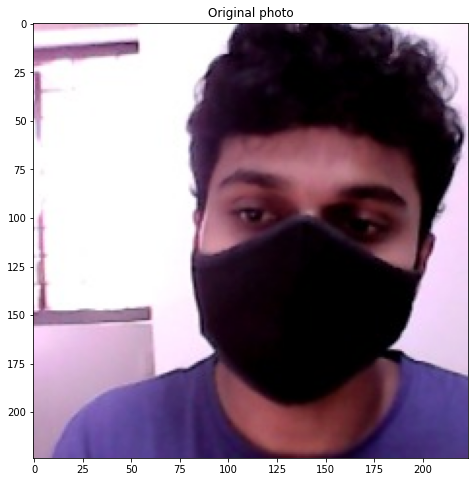

Total predicted classes are: 1
1


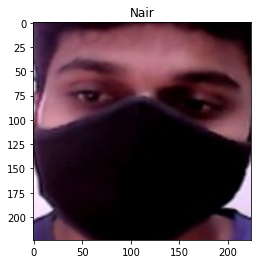

[[1.7255660e-15 1.0000000e+00 1.0515833e-11 6.2489691e-15]]


In [61]:
test_model1_on_photo_from_path("72.jpg", True)

# Transfer Learning

In [48]:
from keras.layers import BatchNormalization

model_vgg16 = vgg16.VGG16(include_top=False, pooling="max", input_shape = (224, 224, 3)) 

new_layer = Dense(256, activation = 'relu')(model_vgg16.output)
new_layer = Dropout(rate = 0.5)(new_layer)

new_layer = Dense(128, activation = 'relu')(new_layer)
new_layer = Dropout(rate = 0.5)(new_layer)
new_layer = BatchNormalization()(new_layer)
new_layer = Dense(4, activation="softmax")(new_layer)

model2 = models.Model(model_vgg16.input, new_layer)

for i in range(len(model_vgg16.layers)):
  model2.layers[i].trainable = False

print(model2.summary())

Model: "model_27"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_28 (InputLayer)        [(None, 224, 224, 3)]     0         
_________________________________________________________________
block1_conv1 (Conv2D)        (None, 224, 224, 64)      1792      
_________________________________________________________________
block1_conv2 (Conv2D)        (None, 224, 224, 64)      36928     
_________________________________________________________________
block1_pool (MaxPooling2D)   (None, 112, 112, 64)      0         
_________________________________________________________________
block2_conv1 (Conv2D)        (None, 112, 112, 128)     73856     
_________________________________________________________________
block2_conv2 (Conv2D)        (None, 112, 112, 128)     147584    
_________________________________________________________________
block2_pool (MaxPooling2D)   (None, 56, 56, 128)       0  

In [48]:
# Compiling the CNN
model2.compile(optimizer = 'adam',
                   loss='categorical_crossentropy',
                   metrics = ['categorical_accuracy'])

In [ ]:
from keras.callbacks import EarlyStopping, ModelCheckpoint

early_stop = EarlyStopping(monitor='val_loss', patience = 3)
checkpoint = ModelCheckpoint('facial_recongition_TL1.h5', monitor = 'val_accuracy')

In [61]:
history = model2.fit(pre_au_x_train, au_train_labels, 
                     batch_size = 32, epochs= 1, 
                     validation_data = (pre_au_x_test, au_test_labels), 
                     callbacks = [early_stop, checkpoint])

139/139 [==============================] - 1249s 9s/step - loss: 0.0981 - categorical_accuracy: 0.9685 - val_loss: 0.0411 - val_categorical_accuracy: 0.9895


In [49]:
preds = model2.predict(pre_au_x_test, batch_size=50) # y_test are the truth, real labels correct ones.
# classes are the model predictions (That can be wrong or match the real ones)
print("Total predicted classes are:",len(preds))

KeyboardInterrupt: 

In [ ]:
from sklearn.metrics import accuracy_score
accuracy_score(au_test_labels.argmax(axis=1), preds.argmax(axis=1))

In [65]:
from sklearn.metrics import classification_report, confusion_matrix
y_pred = np.argmax(preds, axis=1)
print('Confusion Matrix')
print(confusion_matrix(au_y_test, y_pred))
print('Classification Report')
target_names = ['Kavya', 'Nair', 'Nikhil', 'Nithya' ]
print(classification_report(au_y_test, y_pred, target_names=target_names))

Confusion Matrix
[[184 161 128 152]
 [185 153 137 126]
 [141 126 103  94]
 [144 128 103 126]]
Classification Report
              precision    recall  f1-score   support

       Kavya       0.28      0.29      0.29       625
        Nair       0.27      0.25      0.26       601
      Nikhil       0.22      0.22      0.22       464
      Nithya       0.25      0.25      0.25       501

    accuracy                           0.26      2191
   macro avg       0.26      0.26      0.26      2191
weighted avg       0.26      0.26      0.26      2191



In [44]:
from keras.models import load_model
best_model = load_model('facial_recongition_TL1.h5')

In [48]:
def test_model_on_photo_all_faces_from_path(file_path,verbose=False):
  recognized_person = {0:'Kavya',1:'Nair', 2:'Nikhil', 3:'Nithya'}
  plt.figure(figsize=(10, 8))
  original_image = Image.open(file_path)
  plt.title("Original photo")
  plt.imshow(original_image)
  plt.show()
  images = extract_all_faces(file_path)
  for image in images:
    preprocessed_image = preprocess_input(image)
    shaped_img = preprocessed_image.reshape(1,224,224,3)
    classes = model2.predict(shaped_img) # y_test are the truth, real labels correct ones.
    # classes are the model predictions (That can be wrong or match the real ones)
    print("Total predicted classes are:",len(classes))
    print(int(classes.argmax(axis=1)))
    plt.title(recognized_person[int(classes.argmax(axis=1))])
    plt.imshow(image)
    plt.show()
    if verbose:
      print(classes)

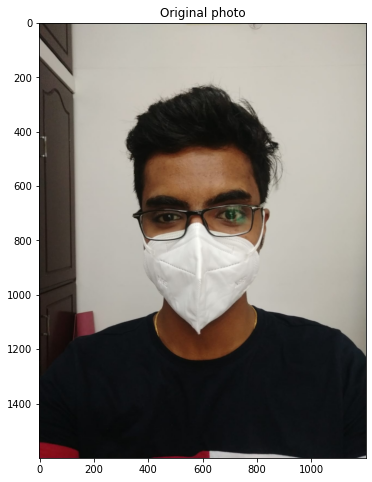

(554, 438, 3)
Total predicted classes are: 1
2


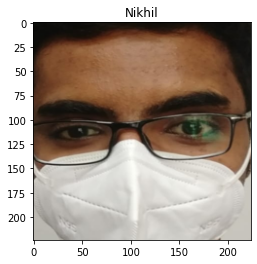

In [66]:
test_model_on_photo_all_faces_from_path("Nikhil4.jpg")